In [4]:
import os
import sys
import numpy as np
from easydict import EasyDict
from torch.utils.data import Dataset
import matplotlib.pyplot as plt
import copy
import json
import pickle
from data.scannet.model_util_scannet import rotate_aligned_boxes, ScannetDatasetConfig, rotate_aligned_boxes_along_axis
from utils.pc_utils import random_sampling, rotx, roty, rotz

from tqdm import tqdm
from tqdm import tnrange, tqdm_notebook

In [5]:
CONF = EasyDict()

# path
CONF.PATH = EasyDict()
CONF.PATH.BASE = "/home/master/08/lluma0208/ScanRefer/" # TODO: change this
CONF.PATH.DATA = os.path.join(CONF.PATH.BASE, "data")
CONF.PATH.SCANNET = os.path.join(CONF.PATH.DATA, "scannet")

# scannet data path
CONF.PATH.GLOVE_PICKLE = os.path.join(CONF.PATH.DATA, "glove.p")
CONF.PATH.EMBEDDING_PATH = os.path.join(CONF.PATH.DATA, "glove.6B.300d.txt")
CONF.PATH.VOCAB = os.path.join(CONF.PATH.DATA, "vocab_file.txt")
CONF.PATH.SCANNET_SCANS = os.path.join(CONF.PATH.SCANNET, "scans")
CONF.PATH.SCANNET_META = os.path.join(CONF.PATH.SCANNET, "meta_data")
CONF.PATH.SCANNET_DATA = os.path.join(CONF.PATH.SCANNET, "scannet_data")
CONF.PATH.SCANNET_SCENE_LIST = os.path.join(CONF.PATH.SCANNET_META, "scannetv2.txt")
CONF.PATH.SCANNET_V2_TSV = os.path.join(CONF.PATH.SCANNET_META, "scannetv2-labels.combined.tsv")
CONF.PATH.SCANREFER_ALL = os.path.join(CONF.PATH.DATA, "ScanRefer_filtered.json")
CONF.PATH.SCANREFER_TRAIN = os.path.join(CONF.PATH.DATA, "ScanRefer_filtered_train.json")
CONF.PATH.SCANREFER_VAL = os.path.join(CONF.PATH.DATA, "ScanRefer_filtered_val.json")

# scannet training setting
CONF.TRAINING = EasyDict()
CONF.TRAINING.USE_COLOR = False
CONF.TRAINING.MAX_NUM_OBJ = 128
CONF.TRAINING.NUM_POINTS = 40000
CONF.TRAINING.MEAN_COLOR_RGB = np.array([109.8, 97.2, 83.8])

CONF.TRAINING.GRU.HIDDEN = 128

AttributeError: 'EasyDict' object has no attribute 'GRU'

## Embedding

## ScanRefer

In [8]:
class ScanRefer(object):
    
    def __init__(self, embedder, num_scenes=-1, split='train'):
        
        self.embedder = embedder
        self.num_scenes = num_scenes
        self.split = split
        
        # Load
        if self.split == 'train':
            self.train = json.load(open(CONF.PATH.SCANREFER_TRAIN))
            self.scene_list = sorted(list(set([data["scene_id"] for data in self.train])))
            self.data = self._get_filtered_train_data()
        else:
            self.data = json.load(open(CONF.PATH.SCANREFER_VAL))
            self.scene_list = sorted(list(set([data["scene_id"] for data in self.data])))

        self.token_to_indices()
        
    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, idx):
        return self.data[idx]
    
    def token_to_indices(self):
        tnrange = tqdm(enumerate(self.data), total=len(self.data), desc='ScanRefer word indexing')
        for idx, data in tnrange:
            data['indexed_token'] = [self.embedder.to_index(word) for word in data['token']]
        
    def _get_filtered_train_data(self):
        
        if self.num_scenes == -1: 
            self.num_scenes = len(self.scene_list)
        else:
            assert len(self.scene_list) >= self.num_scenes
            
        # Slice train_scene_list
        self.filtered_train_scene_list = self.scene_list[:self.num_scenes]
        
        # Filter data in chosen scenes
        new_scanrefer_train = []
        for data in self.train:
            if data["scene_id"] in self.filtered_train_scene_list:
                new_scanrefer_train.append(data)
                
        return new_scanrefer_train

In [9]:
scanrefer_train = ScanRefer(embedder=embedder, num_scenes=-1, split='train')
scanrefer_val = ScanRefer(embedder=embedder, num_scenes=-1, split='val')

ScanRefer word indexing: 100%|██████████| 9508/9508 [00:00<00:00, 108594.39it/s]


In [10]:
with open(CONF.PATH.SCANNET_SCENE_LIST, "r") as f:
    scene_list = [row.strip() for row in f.readlines()]
    f.close()

In [12]:
scanrefer_train.filtered_train_scene_list[0]

'scene0000_00'

In [11]:
len(scanrefer_train.data)

36665

In [9]:
len(scanrefer_val.data)

9508

In [10]:
def get_scanrefer_detail_info(data, split='train'):
    
    scene_objs = {}
    min_num_tokens = np.inf
    max_num_tokens = -1
    avg_num_tokens = 0
    all_tokens = []
    
    for item in data:  
        scene_id = item['scene_id']
        if len(item['token']) < min_num_tokens:
            min_num_tokens = len(item['token'])
        
        if len(item['token']) > max_num_tokens:
            max_num_tokens = len(item['token'])
        
        avg_num_tokens += len(item['token'])
        
        for token in item['token']:
            all_tokens.append(token)
        
        if scene_id not in scene_objs.keys():
            scene_objs[scene_id] = {}
            scene_objs[scene_id]['data'] = [copy.deepcopy(item)]
            scene_objs[scene_id]['object_ids'] = [copy.deepcopy(item['object_id'])]
        else:
            scene_objs[scene_id]['data'].append(copy.deepcopy(item))
            scene_objs[scene_id]['object_ids'].append(copy.deepcopy(item['object_id']))   
    
    info = {}
    info['split'] = split
    info['num_scenes'] = len(scene_objs.keys())

    info['num_objects'] = sum(len(list(set(scene_objs[scene_id]['object_ids']))) for scene_id in scene_objs.keys())
    info['num_objects_per_scene'] =  '%.2f' % (info['num_objects'] / info['num_scenes'])
    
    info['num_descriptions'] = sum([len(scene_objs[scene_id]['data']) for scene_id in scene_objs.keys()])
    info['num_descriptions_per_scene'] = '%.2f' % (info['num_descriptions'] / info['num_scenes'])
    info['num_descriptions_per_object'] = '%.2f' % (info['num_descriptions'] / info['num_objects'])
    
    info['size of vocabulary'] = len(list(set(all_tokens)))
    info['min/avg/max num_tokens '] = '%.2f/%.2f/%.2f' % (min_num_tokens, avg_num_tokens / len(data), max_num_tokens)
    
    return info

In [11]:
scanrefer_info = get_scanrefer_detail_info(scanrefer_train.data + scanrefer_val.data, split='all')
print (scanrefer_info)

{'split': 'all', 'num_scenes': 703, 'num_objects': 9943, 'num_objects_per_scene': '14.14', 'num_descriptions': 46173, 'num_descriptions_per_scene': '65.68', 'num_descriptions_per_object': '4.64', 'size of vocabulary': 4251, 'min/avg/max num_tokens ': '5.00/20.11/126.00'}


## ScanNetv2

### Data format for ScanNet
**Each Scene in scene_data:**
- **mesh_vertices** Point ( position, color, normal ): [ x, y, z, r, g, b, n_x, n_y, n_z ] * 50000 points .
- **instance_labels** Point ( instance index ): [ labeled instance index for this point ] * 50000 points .
- **semantic_labels** Point ( semantic category index ): [ labeled category index for this point ] * 50000 points .
- **instance_bboxes** Box ( center_position, x-axis length, y-axis length, z-axis length, semantic label, instance label ): [ c_x, c_y, c_z, dx, dy, dz, semantic_id, instance_id] * #instances in this scene .

**Labeled classes map:**
- id 
- raw_category
- category 
- count
- nyu40id
- eigen13id
- nyuClass
- nyu40class
- eigen13class
- ModelNet40
- ModelNet10
- ShapeNetCore55
- synsetoffset
- wnsynsetid
- wnsynsetkey
- mpcat40
- mpcat40index

In [20]:
class ScanNetDataset(Dataset):
    def __init__(self, scanrefer, embedder, split="train", augment=False, debug=False):
       
        self.scanrefer = scanrefer
        self.embedder = embedder
        self.split = split
        self.augment = augment
        self.debug = debug
        self.scene_list = self.scanrefer.scene_list if self.scanrefer else self._load_scannet_scene_list()
        
        with open(CONF.PATH.SCANNET_V2_TSV) as f:
            lines = [line.rstrip() for line in open(CONF.PATH.SCANNET_V2_TSV)]
            # Remove the first row about the data titles.
            self.classes_map = lines[1:]
           
        self._load_scannet_data()
        
        self.num_points = CONF.TRAINING.NUM_POINTS
        self.max_num_obj = CONF.TRAINING.MAX_NUM_OBJ
        self.use_color = CONF.TRAINING.USE_COLOR
        
        self._prepare_scannet_data()
        
    def __len__(self):
        return len(self.sample_data)
    
    def __getitem__(self, idx):
        return self.sample_data[idx]
  
    
    def _translate(self, point_set, bbox):
        # unpack
        coords = point_set[:, :3]

        # translation factors
        x_factor = np.random.choice(np.arange(-0.5, 0.501, 0.001), size=1)[0]
        y_factor = np.random.choice(np.arange(-0.5, 0.501, 0.001), size=1)[0]
        z_factor = np.random.choice(np.arange(-0.5, 0.501, 0.001), size=1)[0]
        factor = [x_factor, y_factor, z_factor]
        
        # dump
        coords += factor
        point_set[:, :3] = coords
        bbox[:, :3] += factor

        return point_set, bbox
    
    def _load_scannet_scene_list(self):
        with open(CONF.PATH.SCANNET_SCENE_LIST, "r") as f:
            scene_list = [row.strip() for row in f.readlines()]
            f.close()
        return scene_list
    
    def _get_raw2nyuid(self):
        
        raw2nyuid = {}
        for line in self.classes_map:
            ele = line.split('\t')
            raw_name = ele[1]
            nyu40_id = int(ele[4])
            raw2nyuid[raw_name] = nyu40_id
            
        return raw2nyuid
            
    def _get_raw2label(self):
        '''
            ScanNet label classes in DC.type2class (18 classes): 
            0  'cabinet',
            1  'bed',
            2  'chair',
            3  'sofa',
            4  'table',
            5  'door',
            6  'window',
            7  'bookshelf', 
            8  'picture',
            9  'counter',
            10 'desk',
            11 'curtain',
            12 'refrigerator',
            13 'shower curtain', 
            14 'toilet',
            15 'sink',
            16 'bathtub', 
            17 'others'
        '''
        ### Mapping NYU40 labeled classes to ScanNet labeled classes.
        DC = ScannetDatasetConfig()
        scannet_labels = DC.type2class.keys()
        scannet2label = {label: i for i, label in enumerate(scannet_labels)}
        
        raw2label = {}
        for line in self.classes_map:
            label_classes_set = set(scannet_labels)
            ele = line.split('\t')
            raw_name = ele[1]
            nyu40_name = ele[7]
            
            if nyu40_name not in label_classes_set:
                raw2label[raw_name] = scannet2label['others']
            else:
                raw2label[raw_name] = scannet2label[nyu40_name]

        return raw2label
    
    def _load_scannet_data(self):
        
        print ('Loading ScanNet data...')
        self.scene_data = {}
        
        ### Loading mesh data (mesh_vertices) and the annotation data
        #  (instance_labels, semantic_labels, instance_bboxes) we need.
        for scene_id in self.scene_list:
            self.scene_data[scene_id] = {}
            self.scene_data[scene_id]["mesh_vertices"] = np.load(os.path.join(CONF.PATH.SCANNET_DATA, scene_id)+"_vert.npy")
            self.scene_data[scene_id]["instance_labels"] = np.load(os.path.join(CONF.PATH.SCANNET_DATA, scene_id)+"_ins_label.npy")
            self.scene_data[scene_id]["semantic_labels"] = np.load(os.path.join(CONF.PATH.SCANNET_DATA, scene_id)+"_sem_label.npy")
            self.scene_data[scene_id]["instance_bboxes"] = np.load(os.path.join(CONF.PATH.SCANNET_DATA, scene_id)+"_bbox.npy")
        
        ### Loading the class mapping for different subset dataset settings
        
        ## ScanNet classes indices to NYU40 classes indices.
        self.raw2nyuid = self._get_raw2nyuid()
        self.raw2label = self._get_raw2label()
    
    def _process_sample(self, idx):
        
        ### Get the data information in annotation item.
        scene_id = self.scanrefer[idx]['scene_id']
        object_id = int(self.scanrefer[idx]['object_id'])
        object_name = " ".join(self.scanrefer[idx]["object_name"].split("_"))
        ann_id = int(self.scanrefer[idx]["ann_id"])
        
        ### Get the referring expression
        description = self.scanrefer[idx]["indexed_token"]
        original_description = self.scanrefer[idx]['description']
        
        ### Get the original annotation data.
        mesh_vertices = self.scene_data[scene_id]["mesh_vertices"]
        instance_labels = self.scene_data[scene_id]["instance_labels"]
        semantic_labels = self.scene_data[scene_id]["semantic_labels"]
        instance_bboxes = self.scene_data[scene_id]["instance_bboxes"]
        
        ### Get point cloud data
        if not self.use_color:
            point_cloud = mesh_vertices[:,0:3] # do not use color for now
            pcl_color = mesh_vertices[:,3:6]
        else:
            point_cloud = mesh_vertices[:,0:6] 
            point_cloud[:,3:] = (point_cloud[:,3:] - CONF.TRAINING.MEAN_COLOR_RGB) / 256.0
            pcl_color = point_cloud[:,3:]
        
        ### Sampling points
        point_cloud, choices = random_sampling(point_cloud, self.num_points, return_choices=True)        
        instance_labels = instance_labels[choices]
        semantic_labels = semantic_labels[choices]
        pcl_color = pcl_color[choices]
        
        ### Specify the number of box we need to predict and create a mask for it.
        # num_bbox = instance_bboxes.shape[0] if instance_bboxes.shape[0] < self.max_num_obj else self.max_num_obj
        # target_bboxes_mask = np.zeros((self.max_num_obj))
        # target_bboxes_mask[0:num_bbox] = 1
        # target_bboxes = instance_bboxes[:num_bbox, 0:6]
        target_bboxes = instance_bboxes
        
        ### Data augmentation (*Warning: after augmenting, target_boxes will be left only 6 element dimension)
        if self.augment and not self.debug:
            if np.random.random() > 0.5:
                # Flipping along the YZ plane
                point_cloud[:,0] = -1 * point_cloud[:,0]
                target_bboxes[:,0] = -1 * target_bboxes[:,0]                
                
            if np.random.random() > 0.5:
                # Flipping along the XZ plane
                point_cloud[:,1] = -1 * point_cloud[:,1]
                target_bboxes[:,1] = -1 * target_bboxes[:,1]                                

            # Rotation along X-axis
            rot_angle = (np.random.random()*np.pi/18) - np.pi/36 # -5 ~ +5 degree
            rot_mat = rotx(rot_angle)
            point_cloud[:,0:3] = np.dot(point_cloud[:,0:3], np.transpose(rot_mat))
            target_bboxes = rotate_aligned_boxes_along_axis(target_bboxes, rot_mat, "x")

            # Rotation along Y-axis
            rot_angle = (np.random.random()*np.pi/18) - np.pi/36 # -5 ~ +5 degree
            rot_mat = roty(rot_angle)
            point_cloud[:,0:3] = np.dot(point_cloud[:,0:3], np.transpose(rot_mat))
            target_bboxes = rotate_aligned_boxes_along_axis(target_bboxes, rot_mat, "y")

            # Rotation along up-axis/Z-axis
            rot_angle = (np.random.random()*np.pi/18) - np.pi/36 # -5 ~ +5 degree
            rot_mat = rotz(rot_angle)
            point_cloud[:,0:3] = np.dot(point_cloud[:,0:3], np.transpose(rot_mat))
            target_bboxes = rotate_aligned_boxes_along_axis(target_bboxes, rot_mat, "z")

            # Translation
            point_cloud, target_bboxes = self._translate(point_cloud, target_bboxes)
              
        ### Build up referred targets' labels 
        sample = {}
        for idx, bbox in enumerate(target_bboxes):
            if int(bbox[-1]) == object_id:
                gt_instance_id = bbox[-1]
                gt_semantic_id = bbox[-2]

                x_min = (2*bbox[0] - bbox[3])/2
                x_max = (2*bbox[0] + bbox[3])/2
                y_min = (2*bbox[1] - bbox[4])/2
                y_max = (2*bbox[1] + bbox[4])/2
                z_min = (2*bbox[2] - bbox[5])/2
                z_max = (2*bbox[2] + bbox[5])/2
                
                sample['point_cloud'] = point_cloud
                sample['object_name'] = object_name
                sample['min_vertex'] = [x_min, y_min, z_min]
                sample['max_vertex'] = [x_max, y_max, z_max]
                sample['class_id'] = int(bbox[-2])
                
                instance_seg = np.zeros_like(instance_labels)
                instance_seg[instance_labels == gt_instance_id] = 1
                sample['instance_seg'] = instance_seg
                sample['description'] = description
                sample['original_description'] = original_description
                
        return sample
    
    def _prepare_scannet_data(self):
        
        print ('Preparing ScanRefer data...')
        
        self.sample_data = []
        tnrange = tqdm(range(len(self.scanrefer)))
        
        for idx in tnrange:
            processed_sample = self._process_sample(idx)
            self.sample_data.append(processed_sample)

In [21]:
scannet_dataset = ScanNetDataset(scanrefer=scanrefer_train, embedder=embedder, split='train', augment=False, debug=False)

Loading ScanNet data...


  0%|          | 37/36665 [00:00<01:39, 368.97it/s]

Preparing ScanRefer data...


100%|██████████| 36665/36665 [01:44<00:00, 350.75it/s]


## Model

In [ ]:
import torch
import torch.nn as nn

In [ ]:
from pointnet2.utils.pointnet2_modules import PointnetFPModule, PointnetSAModuleMSG

class Pointnet2Backbone(nn.Module):
    def __init__(self, input_feature_dim):
        super(Pointnet2Backbone, self).__init__()
        
        self.input_feature_dim = input_feature_dim

        # --------- 4 SET ABSTRACTION LAYERS ---------
        self.sa1 = PointnetSAModuleVotes(
                npoint=2048,
                radius=0.2,
                nsample=64,
                mlp=[input_feature_dim, 64, 64, 128],
                use_xyz=True,
                normalize_xyz=True
            )

        self.sa2 = PointnetSAModuleVotes(
                npoint=1024,
                radius=0.4,
                nsample=32,
                mlp=[128, 128, 128, 256],
                use_xyz=True,
                normalize_xyz=True
            )

        self.sa3 = PointnetSAModuleVotes(
                npoint=512,
                radius=0.8,
                nsample=16,
                mlp=[256, 128, 128, 256],
                use_xyz=True,
                normalize_xyz=True
            )

        self.sa4 = PointnetSAModuleVotes(
                npoint=256,
                radius=1.2,
                nsample=16,
                mlp=[256, 128, 128, 256],
                use_xyz=True,
                normalize_xyz=True
            )
        
        # --------- 2 FEATURE UPSAMPLING LAYERS --------
        self.fp1 = PointnetFPModule(mlp=[256+256,256,256])
        self.fp2 = PointnetFPModule(mlp=[256+256,256,256])
           
    def _break_up_pc(self, pc):
        xyz = pc[..., :3].contiguous()
        features = pc[..., 3:].transpose(1, 2).contiguous() if pc.size(-1) > 3 else None

        return xyz, features

    def forward(self, pc, l_features):
        """
            Forward pass of the network

            Parameters
            ----------
            pointcloud: Variable(torch.cuda.FloatTensor)
                (B, N, 3 + input_feature_dim) tensor
                Point cloud to run predicts on
                Each point in the point-cloud MUST
                be formated as (x, y, z, features...)

            Returns
            ----------
            data_dict: {XXX_xyz, XXX_features, XXX_inds}
                XXX_xyz: float32 Tensor of shape (B,K,3)
                XXX_features: float32 Tensor of shape (B,K,D)
                XXX-inds: int64 Tensor of shape (B,K) values in [0,N-1]
        """
        
        xyz, features = self._break_up_pc(pc)

        # --------- 4 SET ABSTRACTION LAYERS ---------
        sa1_xyz, sa1_features, sa1_fps_inds = self.sa1(xyz, features)
        sa2_xyz, sa2_features, sa2_fps_inds = self.sa2(sa1_xyz, sa1_features) # this fps_inds is just 0,1,...,1023
        sa3_xyz, sa3_features, sa3_fps_inds = self.sa3(sa2_xyz, sa2_features) # this fps_inds is just 0,1,...,511
        sa4_xyz, sa4_features, sa4_fps_inds = self.sa4(sa3_xyz, sa3_features) # this fps_inds is just 0,1,...,255
        
        ### Fuse point features & language features
        # fused_sa4_features = sa4_features + l_features
        
        # --------- 2 FEATURE UPSAMPLING LAYERS --------
        features = self.fp1(sa3_xyz, sa4_xyz, sa3_features, sa4_features)
        features = self.fp2(sa2_xyz, sa3_xyz, sa2_features, features)
        
        # output_xyz = sa2_xyz
        # num_seed = output_xyz.shape[1]
        # output_indices = sa1_fps_inds[:,0:num_seed] # indices among the entire input point clouds
        # output_features = features
        
        global_features = sa4_features
        local_features = features
        
        return global_features, local_features

In [ ]:
class EmbeddingModule(nn.Module):
    def __init__(self, embedder):
        super(EmbeddingModule, self).__init__()
        self.vocab_size = embedder.get_vocabulary_size()
        self.dim = embedder.get_dim()
        self.embedding = torch.nn.Embedding(self.vocab_size, self.dim)
        self.embedding.weight = torch.nn.Parameter(embedder.vectors)
        
    def forward(self, x):
        return self.embedding(x)

In [ ]:
class LanguageModule(nn.Module):
    def __init__(self, embedder):
        super(LanguageModule, self).__init__()
        self.embedding = EmbeddingModule(embedder)
        self.hidden_dim = CONF.TRAINING.GRU.HIDDEN
        
        ### GRU
        # bidirectional: GRU will inverse the input to get an another hidden from its opposite direction input.
        # batch_first: if True, then the first dimension of input will be batch size.
        self.gru = torch.nn.GRU(vocabulary_size,
                        self.hidden_dim,
                        bidirectional=True,
                        batch_first=True)
        
        ### GRU Initialized
        for name, param in self.gru.named_parameters():
            if 'bias' in name:
                 torch.nn.init.constant_(param, 0.0)
            elif 'weight_ih' in name:
                 torch.nn.init.kaiming_normal_(param)
            elif 'weight_hh' in name:
                 torch.nn.init.orthogonal_(param)
        
    def forward(self, expr):
        
        x_e = self.embedding(expr)
        
        b_e, w_e, e_e = x_e.size() # Batch size x sentence length x vocabulary_size(300)

        x, _ = self.gru(x_e) # Batch size x sentence length x [hidden_dim(128), hidden_dim(128)]

        x = x[:,:,:self.hidden_dim] + x[:,:,self.hidden_dim:] # Batch size x sentence length x hidden_dim(128)
        x = torch.max(x,dim=1)[0] # Batch size x hidden_dim(128)

        return x

In [ ]:
class Baseline(nn.Module):
    def __init__(self, embedder):
        super(Baseline, self).__init__()
        
        self.language_module = LanguageModule(embedder)
        self.backbone_net = Pointnet2Backbone(input_feature_dim=self.input_feature_dim)
        
    def forward(self, pc, expr):
        
        l_features = self.language_module(expr)
        # global_features, local_features = self.backbone_net(pc, l_features)
        

In [ ]:
model = Baseline(embedder)

## Training

In [28]:
tnrange = tqdm(enumerate(scannet_dataset), total=len(scannet_dataset), desc="data")

for idx, data in tnrange:
    print (idx, data)

    if idx == 0:
        break







data:   0%|          | 0/36665 [00:00<?, ?it/s]





data:   0%|          | 0/36665 [00:09<?, ?it/s]

0 {'object_name': 'cabinet', 'min_vertex': [-3.450779438018799, -3.5141968727111816, -0.028912067413330078], 'max_vertex': [-2.849522113800049, -2.296323299407959, 1.9092012643814087], 'class_id': 3, 'instance_seg': array([0, 0, 0, ..., 0, 0, 0], dtype=uint32), 'description': [7, 262, 949, 6, 0, 1601, 3, 0, 694, 2, 6, 0, 1400, 24, 0, 1238, 5, 24, 0, 760, 2, 19, 40, 27, 12, 0, 196, 1, 60, 13, 7, 310, 762, 1187, 12, 0, 196, 362, 3, 0, 949, 5, 7, 1173, 1187, 12, 0, 221, 362, 3, 0, 949], 'original_description': 'a white cabinet in the corner of the room. in the direction from the door and from the inside . it will be on the left, there is a small brown table on the left side of the cabinet and a smaller table on the right side of the cabinet'}


In [17]:
scannet_dataset.raw2nyuid

{'wall': 1,
 'chair': 5,
 'books': 23,
 'floor': 2,
 'door': 8,
 'object': 40,
 'window': 9,
 'table': 7,
 'trash can': 39,
 'pillow': 18,
 'picture': 11,
 'ceiling': 22,
 'box': 29,
 'doorframe': 8,
 'monitor': 40,
 'cabinet': 3,
 'desk': 14,
 'shelf': 15,
 'office chair': 5,
 'towel': 27,
 'couch': 6,
 'sink': 34,
 'backpack': 40,
 'lamp': 35,
 'bed': 4,
 'bookshelf': 10,
 'mirror': 19,
 'curtain': 16,
 'plant': 40,
 'whiteboard': 30,
 'radiator': 39,
 'book': 23,
 'kitchen cabinet': 3,
 'toilet paper': 40,
 'kitchen cabinets': 3,
 'armchair': 5,
 'shoes': 40,
 'coffee table': 7,
 'toilet': 33,
 'bag': 37,
 'clothes': 21,
 'keyboard': 40,
 'bottle': 40,
 'recycling bin': 39,
 'nightstand': 32,
 'stool': 40,
 'tv': 25,
 'file cabinet': 3,
 'dresser': 17,
 'computer tower': 40,
 'clothing': 21,
 'telephone': 40,
 'cup': 40,
 'refrigerator': 24,
 'end table': 7,
 'jacket': 40,
 'shower curtain': 28,
 'bathtub': 36,
 'microwave': 40,
 'kitchen counter': 12,
 'sofa chair': 5,
 'paper towe

In [18]:
scannet_dataset.raw2label

{'wall': 17,
 'chair': 2,
 'books': 17,
 'floor': 17,
 'door': 5,
 'object': 17,
 'window': 6,
 'table': 4,
 'trash can': 17,
 'pillow': 17,
 'picture': 8,
 'ceiling': 17,
 'box': 17,
 'doorframe': 5,
 'monitor': 17,
 'cabinet': 0,
 'desk': 10,
 'shelf': 17,
 'office chair': 2,
 'towel': 17,
 'couch': 3,
 'sink': 15,
 'backpack': 17,
 'lamp': 17,
 'bed': 1,
 'bookshelf': 7,
 'mirror': 17,
 'curtain': 11,
 'plant': 17,
 'whiteboard': 17,
 'radiator': 17,
 'book': 17,
 'kitchen cabinet': 0,
 'toilet paper': 17,
 'kitchen cabinets': 0,
 'armchair': 2,
 'shoes': 17,
 'coffee table': 4,
 'toilet': 14,
 'bag': 17,
 'clothes': 17,
 'keyboard': 17,
 'bottle': 17,
 'recycling bin': 17,
 'nightstand': 17,
 'stool': 17,
 'tv': 17,
 'file cabinet': 0,
 'dresser': 17,
 'computer tower': 17,
 'clothing': 17,
 'telephone': 17,
 'cup': 17,
 'refrigerator': 12,
 'end table': 4,
 'jacket': 17,
 'shower curtain': 13,
 'bathtub': 16,
 'microwave': 17,
 'kitchen counter': 9,
 'sofa chair': 2,
 'paper towel

Max number of num_instances:  83


Text(0.5, 1.0, 'Histogram of #Instance in scenes')

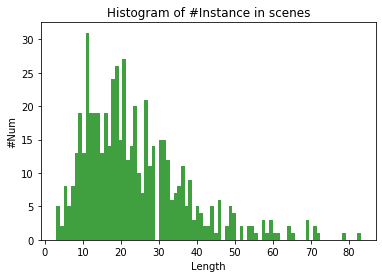

In [19]:
num_instances = []
for i in scannet_dataset.scene_list:
    num_instance = len(scannet_dataset.scene_data[i]['instance_bboxes'])
    num_instances.append(num_instance)
max_num_instance = max(num_instances)

print ('Max number of num_instances: ', max_num_instance)
n, bins, patches = plt.hist(num_instances, max_num_instance, facecolor='g', alpha=0.75)

plt.xlabel('Length')
plt.ylabel('#Num')
plt.title('Histogram of #Instance in scenes')

### Visualize

In [21]:
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

In [36]:
scene_id = 0
class_name = 'table'
scene = scannet_dataset.scene_data[scannet_dataset.scene_list[scene_id]]
nyu_class_id = scannet_dataset.raw2nyuid[class_name]

print ('nyu_class_id:', nyu_class_id)

nyu_class_id: 7


#### Data format for bounding box
- **center_x** = (**x_min** + **x_max**) / 2
- **center_y** = (**y_min** + **y_max**) / 2
- **center_z** = (**z_min** + **z_max**) / 2
- **length_x** = (**x_max** - **x_min**)
- **length_y** = (**y_max** - **y_min**)
- **length_z** = (**z_max** - **z_min**)

In [37]:
def getBoundingBoxVertices(bbox):
    x_min = (2*bbox[0] - bbox[3])/2
    x_max = (2*bbox[0] + bbox[3])/2
    y_min = (2*bbox[1] - bbox[4])/2
    y_max = (2*bbox[1] + bbox[4])/2
    z_min = (2*bbox[2] - bbox[5])/2
    z_max = (2*bbox[2] + bbox[5])/2
    
    return np.array([
        [x_min, y_min, z_min],
        [x_min, y_max, z_min],
        [x_max, y_max, z_min],
        [x_max, y_min, z_min],
        [x_min, y_min, z_max],
        [x_min, y_max, z_max],
        [x_max, y_max, z_max],
        [x_max, y_min, z_max],
    ])

In [38]:
def get_scene_plot(pc):
    
     return go.Scatter3d(x=pc[:,0], y=pc[:,1], z=pc[:,2],
                               marker=dict(
                                    size=2,
                                    color=pc[:,3:6],                # set color to an array/list of desired values
                                    opacity=1.0
                                ),
                               mode='markers')

In [43]:
def bbox_visualize(scene, class_id, instance_id=-1):
    
    pc = copy.deepcopy(scene["mesh_vertices"])
    bboxes = copy.deepcopy(scene["instance_bboxes"])
    
    target_bboxes = []
    for bbox in bboxes:
        if bbox[6] == class_id:
            target_bboxes.append(bbox)
    print ('There are %d %s in scene %d' % (len(target_bboxes), class_name, scene_id))
    
    scene_plot = get_scene_plot(pc)
    plots = [scene_plot]

    
    
    for i, bbox in enumerate(target_bboxes):
        bbox_vertices = getBoundingBoxVertices(bbox)
        bbox_name = class_name + '_' + str(i)
        plots.append(go.Mesh3d(name=bbox_name, x=bbox_vertices[:,0], y=bbox_vertices[:,1], z=bbox_vertices[:,2],
                            color='#FFB6C1',
                            opacity=0.50,
                            i = [7, 0, 0, 0, 4, 4, 6, 6, 4, 0, 3, 2],
                            j = [3, 4, 1, 2, 5, 6, 5, 2, 0, 1, 6, 3],
                            k = [0, 7, 2, 3, 6, 7, 1, 1, 5, 5, 7, 6],))
        
    fig = go.Figure(data=plots)
    fig.show()

In [44]:
bbox_visualize(scene, nyu_class_id)

There are 3 table in scene 0


In [45]:
def instance_seg_visualize(scene, class_id):
    
    pc = copy.deepcopy(scene["mesh_vertices"])
    instances = copy.deepcopy(scene["instance_labels"])
    semantics = copy.deepcopy(scene["semantic_labels"])
    
    target_semantics = np.zeros_like(semantics)
    target_semantics[semantics == class_id] = 1
    
    semantic_indices = np.argwhere(target_semantics)
    semantic_indices = semantic_indices.reshape(-1)
    
    target_instances = instances[semantic_indices]
    
    pc[semantic_indices, 3:6] = np.array([255,0,0]).reshape(1,3)
    
    scene_plot = get_scene_plot(pc)
    plots = [scene_plot]
    
    fig = go.Figure(data=plots)
    fig.show()

In [46]:
instance_seg_visualize(scene, nyu_class_id)